## Exploration of Hierarchical Weighted Cross Entropy Loss
Using the hxetad.py from hxe-for-tda package + "The Impact of Host-galaxy Properties on Supernova Classification with Hierarchical Labels" to implement hxe for superphot.

In [137]:
import sys
import importlib
from sklearn.preprocessing import StandardScaler
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import torch
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, f1_score, precision_recall_fscore_support
from sklearn.utils import class_weight

Load in data and restrict only to supernova calssifications. Copied and edited from supernova_example.ipynb

In [138]:
# Let's import preprocess our variable star data
scaler = StandardScaler()

# I am adding some conversions here for events which are either "candidates" or have <5 objects
conversions = {'SN Ia-91T-like':'SN Ia-91T', 
               'SN IIn-pec':'SN IIn', 
               'TDE-H-He':'TDE', 'SN IIP':'SN II', 
               'SN IIL': 'SN II', 
               'SN Iax[02cx-like]': 'SN Iax', 
               'SN Ia-91T' : 'SN Ia',
               'SN Ia-91bg-like' : 'SN Ia',
               'SN Ia-CSM'       : 'SN Ia',
               'SN Ia-SC'        : 'SN Ia',
               'SN Ia-pec'       : 'SN Ia',
               'SN Iax'          : 'SN Ia',
               'SN Ib'         : 'SN Ib/c',
               'SN Ib-pec'     : 'SN Ib/c',
               'SN Ibn'        : 'SN Ib/c',
               'SN Ic'         : 'SN Ib/c',
               'SN Ic-BL'      : 'SN Ib/c',
               'SN Ic-Ca-rich' : 'SN Ib/c',
               'SN Ic-pec'     : 'SN Ib/c',
               'SN Icn'        : 'SN Ib/c',
               }
#'SN I': 'SN Ia'
def make_dataset(load=False):
    # to do - eventually, I do want to save/load a dataset...
    if not load:
        metadata, all_labels = np.loadtxt('./data/training_set_dynesty.csv',usecols=(0,1), 
                                          delimiter=',', skiprows=1, dtype=str, unpack=True)

        gind = np.where((all_labels !='Galaxy') & (all_labels !='Other') &  (all_labels !='M dwarf') & (all_labels !='SN I') & (all_labels !='AGN') & (all_labels !='CV') & (all_labels !='ILRT') & (all_labels !='LBV') & (all_labels !='LRN') & (all_labels !='Nova') & (all_labels !='QSO') & (all_labels !='SLSN-II') & (all_labels !='SN') & (all_labels !='SN II-pec') & (all_labels !='SN IIb') & (all_labels != 'TDE') & (all_labels !='Varstar') & (all_labels != 'TDE-H-He'))

        metadata = metadata[gind]
        all_labels = all_labels[gind]
        all_dat = np.zeros((len(all_labels),15))
        
        for key in conversions:
            gind = np.where(all_labels == key)
            all_labels[gind] = conversions[key]
        vertices = np.asarray(np.unique(all_labels),dtype=str)
        print(np.unique(all_labels, return_counts=True))
        vertices = np.append(vertices, ['StellarTransient', 'SN-like', 'ILOT', 'CC'])
        vertices = np.insert(vertices, 0, 'Object')

        for i, md in enumerate(metadata):
            one_sn_data = np.load('./data/dynesty_fits/'+md+'_eqwt_dynesty.npz')
            all_dat[i] = np.mean(one_sn_data['arr_0'],axis=0)
        return(all_labels,all_dat, vertices)

labels,all_features, vertices = make_dataset()
scaler.fit(all_features)
all_features = scaler.transform(all_features)

(array(['SLSN-I', 'SN II', 'SN IIn', 'SN Ia', 'SN Ib/c'], dtype='<U17'), array([  89,  957,  196, 4416,  262]))


In [139]:
print(labels)
print(len(labels))

['SN Ia' 'SN Ia' 'SN Ia' ... 'SN Ia' 'SN Ia' 'SN Ia']
5920


### Build Graph

Define the vertices of the graph/hierarchy.

Note: SNII -> Type IIL/P 

In [140]:
vertices = ['Supernova', 'SN Ia', 'Core-collapse', 'H-rich (II)', 'H-poor (I)', 'SN II', 'SN IIn', 'SN Ib/c', 'SLSN-I']

Hierarchy Position Encoder.
Taken from stackoverflow: https://stackoverflow.com/questions/29586520/can-one-get-hierarchical-graphs-from-networkx-with-python-3
(Used in hxe-for-tda)

In [141]:
def hierarchy_pos(G, root, levels=None, width=1., height=1.):
    '''If there is a cycle that is reachable from root, then this will see infinite recursion.
       G: the graph
       root: the root node
       levels: a dictionary
               key: level number (starting from 0)
               value: number of nodes in this level
       width: horizontal space allocated for drawing
       height: vertical space allocated for drawing'''
    TOTAL = "total"
    CURRENT = "current"
    def make_levels(levels, node=root, currentLevel=0, parent=None):
        """Compute the number of nodes for each level
        """
        if not currentLevel in levels:
            levels[currentLevel] = {TOTAL : 0, CURRENT : 0}
        levels[currentLevel][TOTAL] += 1
        neighbors = G.neighbors(node)
        for neighbor in neighbors:
            if not neighbor == parent:
                levels =  make_levels(levels, neighbor, currentLevel + 1, node)
        return levels

    def make_pos(pos, node=root, currentLevel=0, parent=None, vert_loc=0):
        dx = 1/levels[currentLevel][TOTAL]
        left = dx/2
        pos[node] = ((left + dx*levels[currentLevel][CURRENT])*width, vert_loc)
        levels[currentLevel][CURRENT] += 1
        neighbors = G.neighbors(node)
        for neighbor in neighbors:
            if not neighbor == parent:
                pos = make_pos(pos, neighbor, currentLevel + 1, node, vert_loc-vert_gap)
        return pos
    if levels is None:
        levels = make_levels({})
    else:
        levels = {l:{TOTAL: levels[l], CURRENT:0} for l in levels}
    vert_gap = height / (max([l for l in levels])+1)
    return make_pos({})

Make the graph:

['Supernova', 'SN Ia', 'Core-collapse', 'H-rich (II)', 'H-poor (I)', 'SN II', 'SN IIn', 'SN Ib/c', 'SLSN-I']


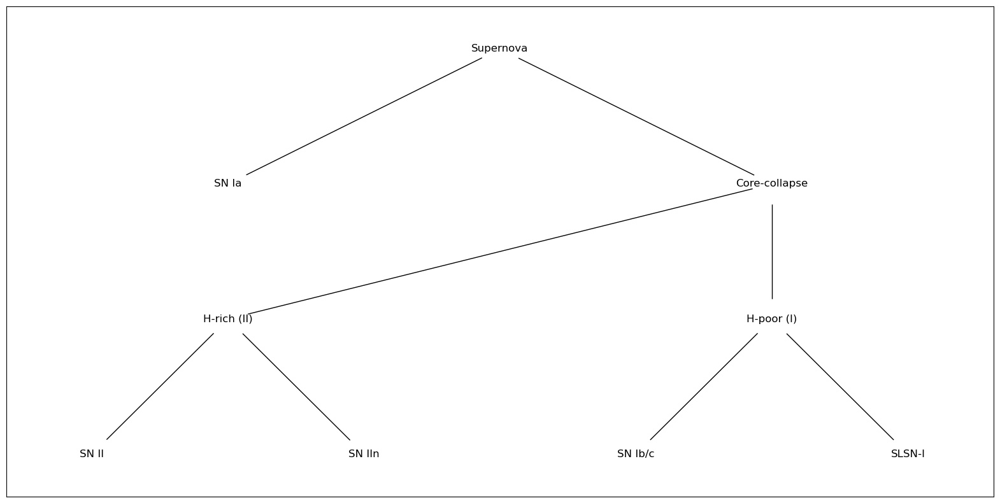

In [142]:
print(vertices)
G = nx.DiGraph()

# h = 4 = H -> h = 3
G.add_edge('Supernova', 'SN Ia')
G.add_edge('Supernova', 'Core-collapse')

# h = 3 -> h = 2
G.add_edge('Core-collapse', 'H-rich (II)')
G.add_edge('Core-collapse', 'H-poor (I)')

# h = 2 -> h = 1
G.add_edge('H-rich (II)', 'SN II')
G.add_edge('H-rich (II)', 'SN IIn')
G.add_edge('H-poor (I)', 'SN Ib/c')
#G.add_edge('H-poor (I)', 'TDE')
G.add_edge('H-poor (I)', 'SLSN-I')

# Encode positions of graph - purely for drawing purposes
pos = hierarchy_pos(G, 'Supernova')
#print(pos)

fig = plt.figure(1, figsize=(20,10))
nx.draw_networkx(G, pos=pos, nodelist=vertices, node_color='white', with_labels=False, node_size=2000, arrows=False)
text = nx.draw_networkx_labels(G, pos)

# Uncomment if need to rotate the labels for a more advanced label system.
# for _, t in text.items():
#     t.set_rotation(45) 

plt.show()


['SLSN-I', 'SLSN-II', 'SN', 'SN II', 'SN II-pec', 'SN IIb', 'SN IIn', 'SN Ia', 'SN Ia-91T', 'SN Ia-91bg-like', 'SN Ia-CSM', 'SN Ia-SC', 'SN Ia-pec', 'SN Iax', 'SN Ib', 'SN Ib-pec', 'SN Ib/c', 'SN Ibn', 'SN Ic', 'SN Ic-BL', 'SN Ic-Ca-rich', 'SN Ic-pec', 'SN Icn', 'TDE', 'SN-like', 'CC', 'SN II-gen']


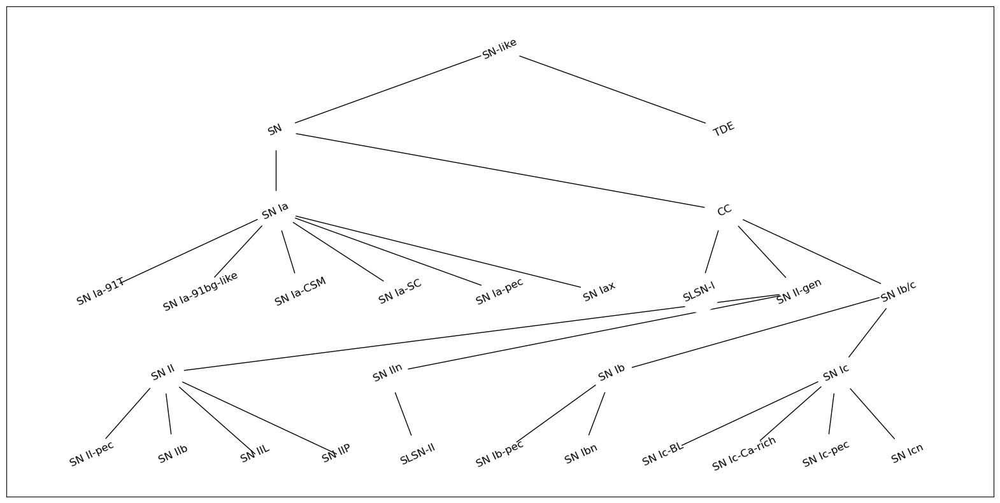

In [136]:
vertices = ['SLSN-I', 'SLSN-II', 'SN', 'SN II', 'SN II-pec', 'SN IIb', 'SN IIn', 
            'SN Ia', 'SN Ia-91T','SN Ia-91bg-like', 'SN Ia-CSM' ,'SN Ia-SC', 
            'SN Ia-pec' ,'SN Iax', 'SN Ib', 'SN Ib-pec', 'SN Ib/c', 'SN Ibn', 
            'SN Ic' ,'SN Ic-BL', 'SN Ic-Ca-rich', 'SN Ic-pec', 'SN Icn', 
            'TDE', 'SN-like', 'CC', 'SN II-gen']

print(vertices)

G = nx.DiGraph()

G.add_edge('SN-like', 'SN')
G.add_edge('SN-like', 'TDE')


G.add_edge('SN', 'SN Ia')
G.add_edge('SN Ia', 'SN Ia-91T')
G.add_edge('SN Ia', 'SN Ia-91bg-like')
G.add_edge('SN Ia', 'SN Ia-CSM')
G.add_edge('SN Ia', 'SN Ia-SC')
G.add_edge('SN Ia', 'SN Ia-pec')
G.add_edge('SN Ia', 'SN Iax')


G.add_edge('SN', 'CC')

G.add_edge('CC', 'SLSN-I')
G.add_edge('CC', 'SN II-gen')

G.add_edge('CC', 'SN Ib/c')
G.add_edge('SN Ib/c', 'SN Ib')
G.add_edge('SN Ib/c', 'SN Ic')

G.add_edge('SN Ib', 'SN Ib-pec')
G.add_edge('SN Ib', 'SN Ibn')

G.add_edge('SN Ic', 'SN Ic-BL')
G.add_edge('SN Ic', 'SN Ic-Ca-rich')
G.add_edge('SN Ic', 'SN Ic-pec')
G.add_edge('SN Ic', 'SN Icn')

G.add_edge('SN II-gen', 'SN II')
G.add_edge('SN II-gen', 'SN IIn')
G.add_edge('SN IIn', 'SLSN-II')

G.add_edge('SN II', 'SN II-pec')
G.add_edge('SN II', 'SN IIb')
G.add_edge('SN II', 'SN IIL')
G.add_edge('SN II', 'SN IIP')

# Encode positions of graph - purely for drawing purposes
pos = hierarchy_pos(G, 'SN-like')
#print(pos)

fig = plt.figure(1, figsize=(20,10))
nx.draw_networkx(G, pos=pos, nodelist=vertices, node_color='white', with_labels=False, node_size=2000, arrows=False)
text = nx.draw_networkx_labels(G, pos)

# Uncomment if need to rotate the labels for a more advanced label system.
for _, t in text.items():
     t.set_rotation(25) 

plt.show()

### Pre-processing on the graph:

Copied and tidied from hxetda.py from hxe-for-tda.

In [143]:
def calc_path_and_mask(G, vertices, root):
	
	adj_mat = np.zeros((len(vertices), len(vertices)))
	pathlengths = []
	all_paths = []
	parent_inds = []

	# This loop: 
	# (1) gets the shortest path between the root and a given node
	# (2) updates pathlengths and all_paths 
	# (3) generates an adjacency matrix representation of G 
	# (4) generates a list where parent_inds[i] = ind in vertices of G[i]'s direct parent
	for i, node in enumerate(vertices):
			
		short_path = nx.shortest_path(G, root, node)

		pathlengths.append(len(short_path))
		all_paths.append(short_path)

		for vert in short_path:
			g_ind = np.where(vert == np.asarray(vertices, dtype='str'))[0]
			adj_mat[i, g_ind[0]] = 1

		if i == 0:
			parent_inds.append(-1)
		else:
			parent_inds.append(np.where(np.asarray(vertices, dtype='str')==next(G.predecessors(node)))[0][0])

	# Makes parent inds into a set of masks to be softmaxed over later. I.e. we are
	# creating a mask for every unique parent in G such that we put 1 in the index of
	# its children as listed in the order of vertices.
	mask_list = []
	# For each of the unique possible parent nodes in the graph...
	for par_ind in np.unique(parent_inds):
		# Skip the root node
		if par_ind == -1:
			continue
		
		# Finds the indicies of the children that have the current parent 
		g_ind = np.where(parent_inds == par_ind)

		# Make a mask the size of vertices/adj_mat, where mask[i] = 1 if child of vertices[par_ind] 
		
		# Note, I think this might be dependent on the ordering of the vertices list 
		# as this does not carry down information about *which* parent is for each mask...
		mask = np.zeros(len(adj_mat))
		mask[g_ind] = 1
		mask_list.append(torch.tensor(mask, dtype=int))
	
	# Combines vertex with list of neighbors, i.e. y_dict[vertex][pot_neighbor] = 1, 
	# if pot_neighbor is neighbor of vertex in G (remember, G is directed)
	y_dict = dict(zip(vertices, adj_mat))
	pathlengths = torch.tensor(pathlengths)

	print(type(all_paths))

	print(type(pathlengths))
	print(type(mask_list))

	print(type(y_dict))

	return all_paths, pathlengths, mask_list, y_dict

In [ ]:
paths, pathlengths, mask_list, y_dict = calc_path_and_mask(G, vertices, 'Supernova')

print('Paths:')
print(len(paths))
print('\n'.join([' -> '.join([str(cell) for cell in row]) for row in paths]))
print(paths)
print()

print('Path Lengths:')
print(len(pathlengths))
print(type(pathlengths))
print(pathlengths)
print()

print('Mask List: ')
print(type(mask_list))
print(len(mask_list))
for row in mask_list:
    print(type(row))
    print(row)

print("Y-Dict: ")
print(type(y_dict))
print(type(y_dict['H-poor (I)']))
import pprint
pp = pprint.PrettyPrinter(indent = 4)
pp.pprint(y_dict)

### Pre-processing for the class weights:

Copied and tidied from hxetda.py from hxe-for-tda.

In [159]:
'''
	Calculates W(c^(h)) = N_all / (N_{labels} * N_c) where:
	N_all = total number of events in the dataset
	N_labels = the number of unique classes
	N_c = the number of events of class c
'''
def calc_class_weights(labels, vertices, all_paths):

	# Get the names and counts of the unique classes within the data set
	ulabels, class_counts = np.unique(labels, return_counts = True)

	# Generates class weight dictionary
	class_weight_dict = {}

	# We need to include everything in the hierarchy under a given label in the count of class c
	for label in ulabels:
		count_for_ulabel = 0

		for label2 in ulabels:
			gind = np.where(np.asarray(vertices, dtype='str') == label2)
			#print("gind", gind)
			if label in all_paths[gind[0][0]]:
				#print(all_paths[gind[0][0]])
				#print("classcount: ", class_counts[np.where(ulabels==label2)])
				count_for_ulabel += class_counts[np.where(ulabels==label2)]

		class_weight_dict[label] = (np.sum(class_counts)/(len(ulabels) * count_for_ulabel))
	return class_weight_dict, class_counts, ulabels

In [160]:
print(type(labels))
print(type(labels[0]))
print(labels)
print(len(labels))

<class 'numpy.ndarray'>
<class 'numpy.str_'>
['SN Ia' 'SN Ia' 'SN Ia' ... 'SN Ia' 'SN Ia' 'SN Ia']
5920


In [162]:
class_weight_dict, class_counts, ulabels = calc_class_weights(labels, vertices, paths)
class_counts

array([  89,  957,  196, 4416,  262])

In [163]:
class_weight_dict

{'SLSN-I': array([13.30337079]),
 'SN II': array([1.23719958]),
 'SN IIn': array([6.04081633]),
 'SN Ia': array([0.26811594]),
 'SN Ib/c': array([4.51908397])}

In [164]:
ulabels

array(['SLSN-I', 'SN II', 'SN IIn', 'SN Ia', 'SN Ib/c'], dtype='<U17')

In [165]:
for f in class_weight_dict.keys():
    print(class_weight_dict[f]*class_counts[np.where(f == ulabels)])

[1184.]
[1184.]
[1184.]
[1184.]
[1184.]


In [118]:
print(type(class_weight_dict['SLSN-I']))

<class 'numpy.ndarray'>


### Now to begin training...

In [81]:
# Set up for train-test split...
labels_new = [y_dict[x] for x in labels]
weights = [class_weight_dict[x] for x in labels] ########<--- Initialize to W(c) term from paper
X_train, X_test, y_train, y_test, labels_train, labels_test, weights_train, weights_test = train_test_split(all_features, labels_new, labels, weights,test_size=0.33)
X_train = torch.tensor(X_train, dtype=torch.float32)
X_test = torch.tensor(X_test, dtype=torch.float32)
y_train = torch.tensor(y_train, dtype=torch.float32)
y_test = torch.tensor(y_test, dtype=torch.float32)

weights_train = torch.tensor(weights_train, dtype=torch.float32)
weights_test = torch.tensor(weights_test, dtype=torch.float32)

print(np.shape(X_train))

torch.Size([3966, 15])


/var/folders/v5/9yjhkpld2z147lmtxg7cdtyr0000gn/T/ipykernel_26754/3497590999.py:7: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/torch/csrc/utils/tensor_new.cpp:257.)
  y_train = torch.tensor(y_train, dtype=torch.float32)


In [123]:
print(type(weights))
print(type(weights[0]))
print(type(labels_new))
print(type(labels_new[0]))

<class 'list'>
<class 'numpy.ndarray'>
<class 'list'>
<class 'numpy.ndarray'>


Define the model -> feedforward neural network (i.e. MLP)

In [82]:
class Feedforward(torch.nn.Module):
		def __init__(self, input_size, hidden_size, output_size):
			super(Feedforward, self).__init__()
			self.input_size = input_size
			self.hidden_size  = hidden_size
			self.output_size  = output_size

			self.fc1 = torch.nn.Linear(self.input_size, self.hidden_size)
			self.relu = torch.nn.Sigmoid()
			self.fc2 = torch.nn.Linear(self.hidden_size, self.hidden_size)
			self.fc3 = torch.nn.Linear(self.hidden_size, self.output_size)
		def forward(self, x):
			hidden = self.fc1(x)
			relu = self.relu(hidden)
			output1 = self.fc2(relu)
			output2 = self.relu(output1)
			output3 = self.fc3(output2)
			return output3

Define the custom loss model

In [ ]:
# Softmax: sigma(z)_i = e^z_i/summation^{K=num classes}_{j=1} (e^z_j)
def masked_softmax(vec, mask, dim=1, epsilon=1e-10):
	# Applies the mask
	# Note, this is multiplying torch.tensors, so it just multiplies the elements, not dot product -_-
    masked_vec = vec * mask.float()

	# exp(masked_vec) -> exp(0) for masked-out, exp(vec[i]) for valid elements
	# each exps_i = e^[masked_vec_{i}]
    exps = torch.exp(masked_vec)
	
	# Need to apply masking again because we need to zero out masked entries again as exp(0)=1
    masked_exps = exps * mask.float()

	# Sums the unmasked exponentials across the class dimension and adds epsilon to avoid division by 0?
    masked_sums = masked_exps.sum(dim, keepdim=True) + epsilon # what is epsilon for?

	# Computes softmax only where mask = 1, preserves original values where mask = 0
    final_vec = masked_exps/masked_sums + ((1-mask) * vec)
    return final_vec

# output -> y_prediction over a batch
# target_weights are weights from model for current batch? 
def custom_hier_loss(output, target, target_weights, mask_list, pathlengths):
	final_sum = 0
	alpha = 1.2 # parameter that one can fine tune

	# sets the first column/entry of output to 1 such that the root node 
	# always has a fixed probability of 1, or log-prod = 0
	output[:, 0] = 1.0 

	# Applies the different parent masks made above to the y_pred to normalize 
	# child probabilities for each set of children/leaves
	for i,mask in enumerate(mask_list):
		output = masked_softmax(output, mask)

	# Apply log to the conditional probabilities
	output = output.log()

	# Apply the lambda = exp(-ah(c)) term
	output = output * np.exp(-alpha * (pathlengths - 1)) # Why the -1?

	# output*target.sum -> picks out log probs along hierarchical path + 
	# 					   sums along this path giving us log joint prob of path or conditional up tree?
	# target_weights * (...) -> This is the multiply by W(c)
	# .mean() -> normalize by the batch size
	final_sum = (target_weights * (output*target).sum(dim=1)).mean()

	return -final_sum

In [99]:
torch.tensor([1, 0, 1])*torch.tensor([.25,0.3,.5])

tensor([0.2500, 0.0000, 0.5000])

### Train the model!

3966
y-pred: tensor([[ 0.1269, -0.2348, -0.1178,  ...,  0.1015, -0.3815, -0.1784],
        [ 0.1279, -0.2428, -0.1132,  ...,  0.1023, -0.3870, -0.1827],
        [ 0.1322, -0.2296, -0.1160,  ...,  0.1067, -0.3893, -0.1699],
        ...,
        [ 0.1414, -0.2321, -0.1151,  ...,  0.0690, -0.3549, -0.1830],
        [ 0.1303, -0.2284, -0.1159,  ...,  0.1049, -0.3860, -0.1703],
        [ 0.1156, -0.2194, -0.1289,  ...,  0.0840, -0.3800, -0.1574]],
       grad_fn=<AddmmBackward0>)
local_y: tensor([[1., 1., 0.,  ..., 0., 0., 0.],
        [1., 1., 0.,  ..., 0., 0., 0.],
        [1., 1., 0.,  ..., 0., 0., 0.],
        ...,
        [1., 0., 1.,  ..., 0., 0., 1.],
        [1., 1., 0.,  ..., 0., 0., 0.],
        [1., 1., 0.,  ..., 0., 0., 0.]])
y-pred: tensor([[ 0.1369, -0.2180, -0.1284,  ...,  0.0998, -0.3792, -0.1787],
        [ 0.1303, -0.2286, -0.1192,  ...,  0.0867, -0.3733, -0.1835],
        [ 0.1355, -0.2181, -0.1254,  ...,  0.1064, -0.3882, -0.1813],
        ...,
        [ 0.1366, -0.2243,

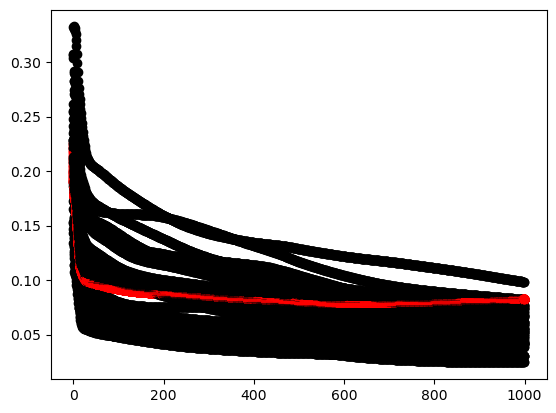

In [100]:

model = Feedforward(np.shape(X_test[0])[0],15, len(vertices))
optimizer = torch.optim.AdamW(model.parameters(), lr = 0.001)
model.train()
epoch = 1000
n_batches = 128
loss=torch.tensor(0)
print(len(X_train))
for epoch in range(epoch):
	if epoch%10==1:
		print(epoch, np.log10(loss.detach().numpy()), np.log10(loss2.detach().numpy()))
	for i in range(int(len(X_train)/n_batches)+1):
		# Local batches and labels
		local_X, local_y, local_weights = X_train[i*n_batches:(i+1)*n_batches,], y_train[i*n_batches:(i+1)*n_batches,], weights_train[i*n_batches:(i+1)*n_batches,]
		optimizer.zero_grad()
		# Forward pass
		y_pred = model(local_X)
		# Compute Loss
		print(f"y-pred: {y_pred.to(torch.float)}")
		print(f"local_y: {local_y.to(torch.float)}")
		loss = custom_hier_loss(y_pred.to(torch.float),local_y.to(torch.float), local_weights, mask_list, pathlengths)
		# Backward pass
		loss.backward()
		optimizer.step()
		plt.plot(epoch,loss.detach().numpy(),'ko')
		ypred2 = model(X_test)
		loss2 = custom_hier_loss(ypred2.to(torch.float),y_test.to(torch.float), weights_test, mask_list, pathlengths)
		plt.plot(epoch,loss2.detach().numpy(),'ro')
	
#scheduler.step()
plt.show()

In [89]:
model.eval()

Feedforward(
  (fc1): Linear(in_features=15, out_features=15, bias=True)
  (relu): Sigmoid()
  (fc2): Linear(in_features=15, out_features=15, bias=True)
  (fc3): Linear(in_features=15, out_features=9, bias=True)
)

In [93]:
y_pred = model(X_test)
y_pred

tensor([[ 5.8677e-02,  2.5904e+00, -2.3209e+00,  ..., -2.9709e-01,
          8.2240e-01, -1.2122e+00],
        [ 1.6298e-01, -7.4561e-01,  1.0440e+00,  ..., -7.3080e-01,
          1.3538e+00, -1.6975e+00],
        [-2.1502e-03,  3.7384e+00, -3.3894e+00,  ...,  2.5652e-02,
         -2.0491e-01, -1.7754e-01],
        ...,
        [ 3.3430e-01, -2.7259e+00,  2.9231e+00,  ..., -4.6980e-01,
          1.2129e+00, -1.5223e+00],
        [-6.7986e-02,  3.6871e+00, -3.5708e+00,  ..., -1.0232e+00,
          1.7058e+00, -2.1498e+00],
        [-2.3331e-03,  2.9354e+00, -2.7126e+00,  ..., -6.8814e-01,
          9.7989e-01, -1.4174e+00]], grad_fn=<AddmmBackward0>)

### Some extra analysis
Copied just directly from hxetda.py and supernova_example.ipynb

In [96]:
def get_prob(input_vec, desired_class, all_paths, vertices, mask_list):
	output = input_vec * 1.0
	output[:,0] = 1.0

	for i,mask in enumerate(mask_list):
		output = masked_softmax(output, mask)
	
	gind = np.where(np.asarray(vertices, dtype='str') == desired_class)
	myprob = torch.ones(len(input_vec))
	for thing in all_paths[gind[0][0]]:
		gind2 = np.where(np.asarray(vertices, dtype='str') == thing)[0]
		myprob = myprob * output[:,gind2[0]]
	return myprob

def is_parent(label_child, desired_parent, vertices, all_paths):
	gind  = np.where(np.asarray(vertices, dtype='str') == label_child)
	if desired_parent in all_paths[gind[0][0]]:
		return True
	else:
		return False

1954
['SN Ia' 'SN Ib/c' 'SN II' 'SLSN-I' 'SN IIn']
SN Ia [9.93139327e-01 3.08569544e-03 3.31390952e-03 1.44575330e-04
 3.16527381e-04]
(0.6111560988031577, 0.49022965932018375, 0.5270300058971464, None)
(0.8694984646878199, 0.8694984646878199, 0.8694984646878199, None)


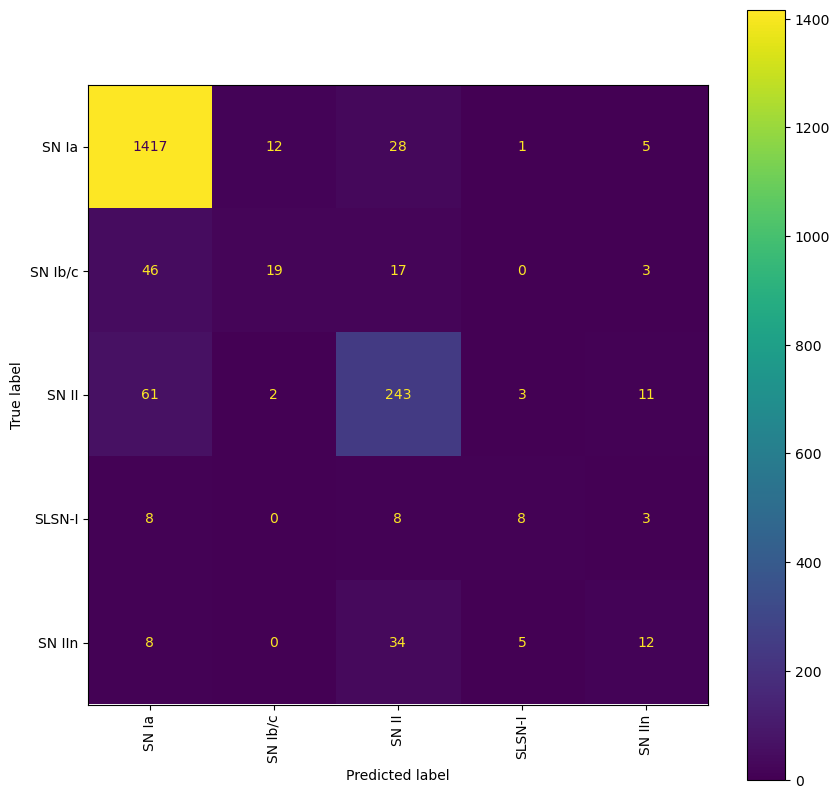

In [97]:
# 5-way task...
# Get my leaves...

leaves = np.asarray(['SN Ia','SN Ib/c', 'SN II', 'SLSN-I', 'SN IIn'], dtype=str)
probs_list = np.zeros((len(y_pred), len(leaves)))
for i,leaf in enumerate(leaves):
    probs_list[:,i] = get_prob(y_pred,leaf, paths, vertices, mask_list).detach().numpy()

my_predicted_types = leaves[np.argmax(probs_list,axis=1)]

fiveleaf_labels_test = np.copy(labels_test)

for i,s in enumerate(fiveleaf_labels_test):
    is_Ibc =  is_parent(s, 'SN Ib/c', vertices, paths)
    if is_Ibc:
        fiveleaf_labels_test[i] = 'SN Ib/c'

gind = np.where(np.in1d(fiveleaf_labels_test,leaves))[0]
cm = confusion_matrix(fiveleaf_labels_test[gind], my_predicted_types[gind], labels=leaves)
disp = ConfusionMatrixDisplay(cm, display_labels=leaves)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(xticks_rotation='vertical', ax=ax)
print(len(gind))
print(leaves)
print(labels_test[gind][9], probs_list[gind][9])

print(precision_recall_fscore_support(fiveleaf_labels_test[gind], my_predicted_types[gind],average='macro'))
print(precision_recall_fscore_support(fiveleaf_labels_test[gind], my_predicted_types[gind],average='micro'))

config.yaml for background graph stuff

class for taxononmy stuff, some class file I could overwrite?

BFS over Djkistra's 

Get started on nn wrapper

Read about calibration, see if anything out there on hierarchy stuff?

In [ ]:
def bfs(G, s): 
    def explore (X,F):
        if len(F) == 0: X
        else:
            # visit the nodes in the frontier
            